In [73]:
!pip install ultralytics opencv-python numpy

In [82]:
from ultralytics import YOLO
import cv2
import numpy as np
from google.colab.patches import cv2_imshow


In [75]:
# PATHS
DATA_YAML = "/content/drive/MyDrive/CF-MADRL-YOLO/dataset_custom.yaml"
# VIDEO_PATH = "/content/drive/MyDrive/CF-MADRL-YOLO/traffic.mp4"
# VIDEO_PATH = "/content/drive/MyDrive/CF-MADRL-YOLO/traffic_jam.mp4"
VIDEO_PATH = "/content/drive/MyDrive/CF-MADRL-YOLO/traffic_jam_2.mp4"
OUTPUT_PATH = "/content/drive/MyDrive/CF-MADRL-YOLO/output_speed_wait.mp4"

# MODELS
BASE_MODEL = "yolo26n.pt"
CUSTOM_MODEL_PATH = "runs/detect/custom_yolo26/weights/best.pt" #model train bhaesi store huncha runs folder ma
TRAIN_EPOCHS = 50

# PARAMETERS
IMG_SIZE = 640
CONF_THRES = 0.3
PIXEL_TO_METER = 0.05

STOP_SPEED_KMH = 2.0      # below this = stopped
MATCH_DIST_PX = 50        # vehicle association distance

# COCO classes
VEHICLE_CLASSES = [1, 2, 3, 5, 7]

In [76]:
# Train using YOLO26 base

# train_model = YOLO(BASE_MODEL)

# train_model.train(
#     data=DATA_YAML,
#     epochs=TRAIN_EPOCHS,
#     imgsz=IMG_SIZE,
#     batch=8,
#     workers=2,
#     name="custom_yolo26"
# )


In [77]:
#Load BOTH Models
custom_model = YOLO(CUSTOM_MODEL_PATH)
fallback_model = YOLO(BASE_MODEL)

In [83]:
#  VIDEO
cap = cv2.VideoCapture(VIDEO_PATH)
width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps    = cap.get(cv2.CAP_PROP_FPS)

out = cv2.VideoWriter(
    OUTPUT_PATH,
    cv2.VideoWriter_fourcc(*"mp4v"),
    fps,
    (width, height)
)

#  WAIT ZONE (ROI)
ROI_Y_MIN = int(height * 0.55)
ROI_Y_MAX = int(height * 0.85)

#  TRACK STORAGE
vehicle_tracks = {}

#  HELPER
def find_near_vehicle(cx, cy):
    for tid, data in vehicle_tracks.items():
        px, py = data["pos"]
        if np.hypot(cx - px, cy - py) < MATCH_DIST_PX:
            return tid
    return None


0: 384x640 (no detections), 23.5ms
Speed: 3.0ms preprocess, 23.5ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 11.2ms
Speed: 2.0ms preprocess, 11.2ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)


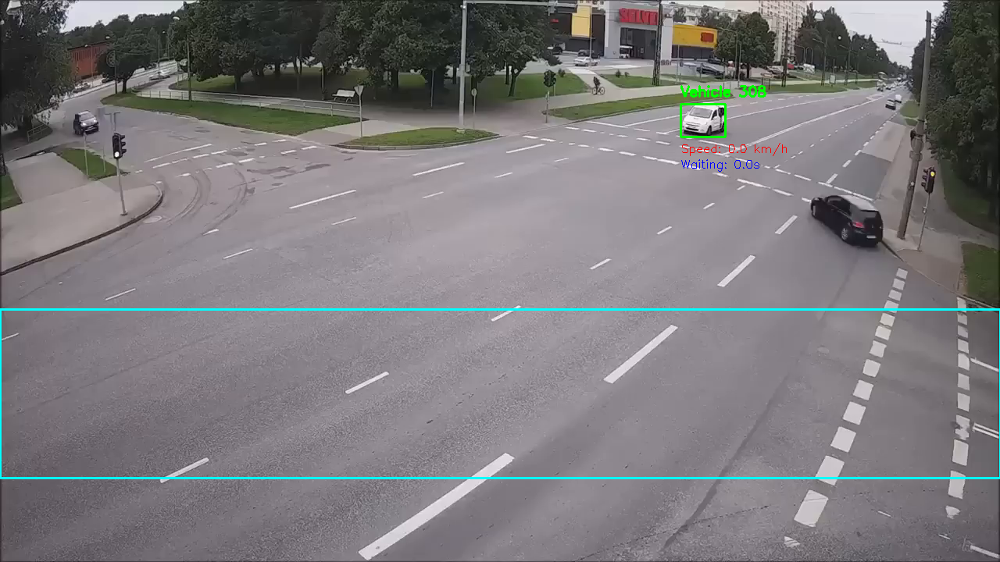


0: 384x640 (no detections), 16.6ms
Speed: 3.3ms preprocess, 16.6ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 14.3ms
Speed: 2.3ms preprocess, 14.3ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


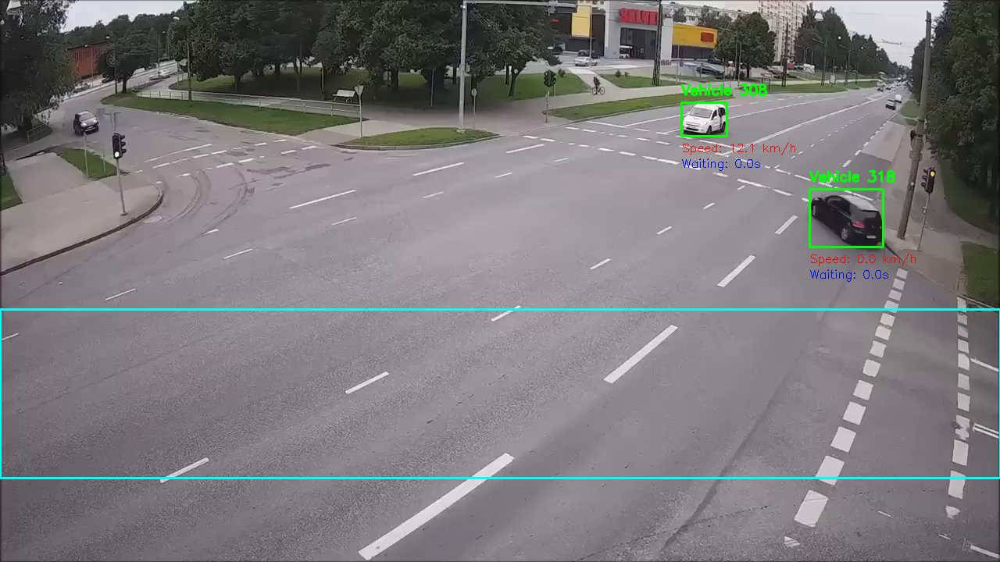


0: 384x640 (no detections), 16.6ms
Speed: 2.1ms preprocess, 16.6ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 17.7ms
Speed: 2.1ms preprocess, 17.7ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


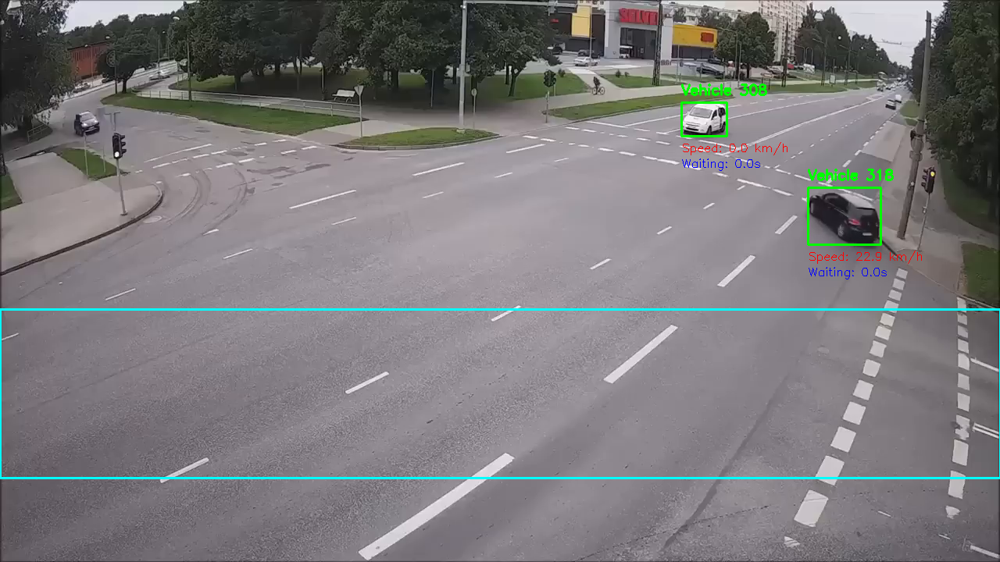


0: 384x640 (no detections), 14.2ms
Speed: 1.9ms preprocess, 14.2ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 15.2ms
Speed: 2.2ms preprocess, 15.2ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


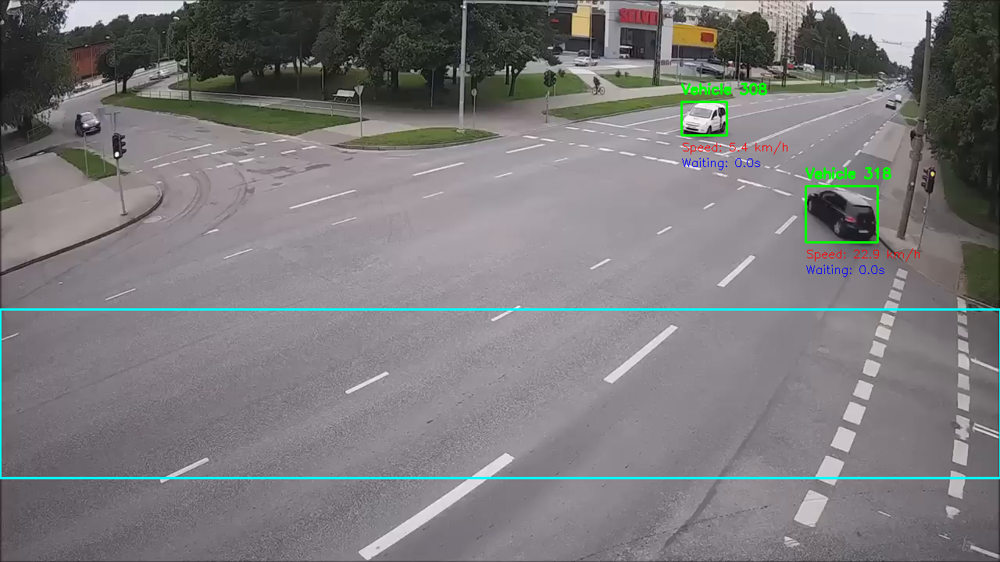


0: 384x640 (no detections), 14.5ms
Speed: 2.5ms preprocess, 14.5ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 14.8ms
Speed: 1.9ms preprocess, 14.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


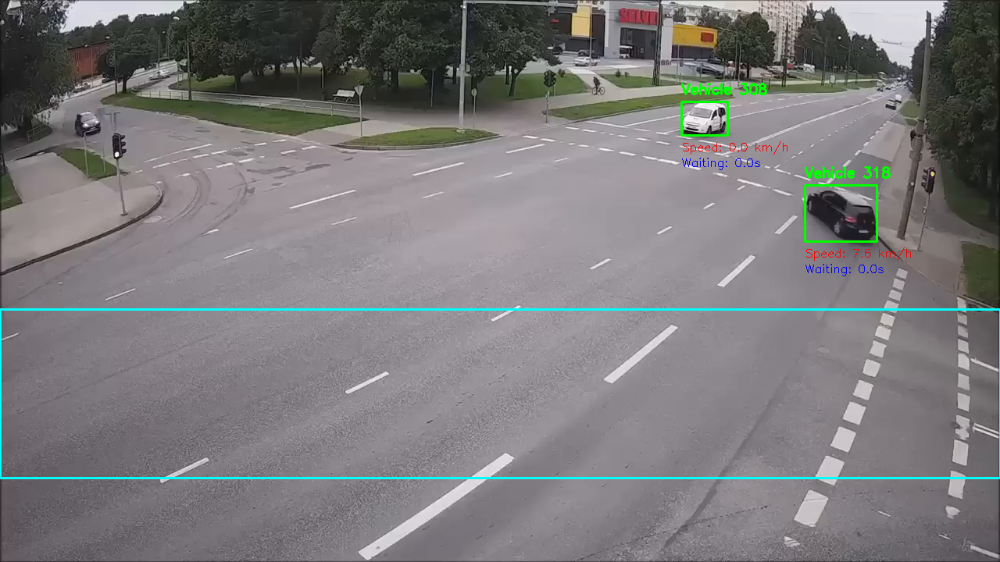


0: 384x640 (no detections), 15.9ms
Speed: 2.7ms preprocess, 15.9ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 15.2ms
Speed: 1.9ms preprocess, 15.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


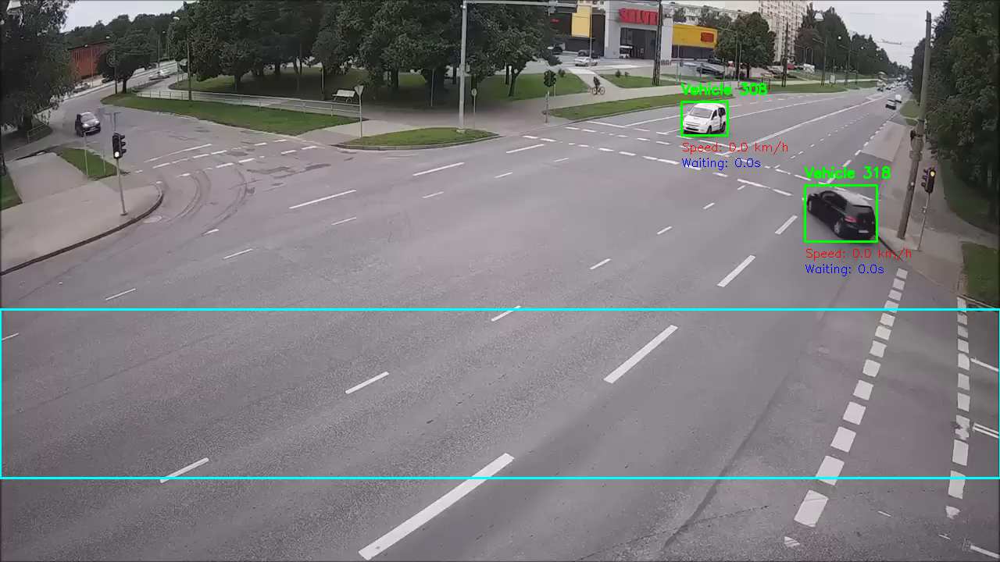


0: 384x640 (no detections), 14.6ms
Speed: 2.4ms preprocess, 14.6ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 15.2ms
Speed: 2.2ms preprocess, 15.2ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


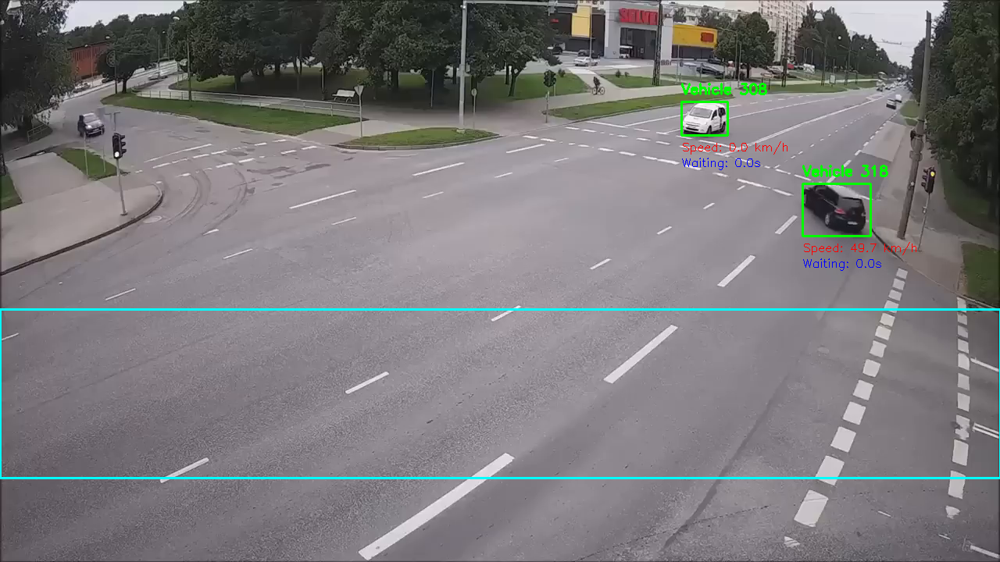


0: 384x640 (no detections), 21.0ms
Speed: 2.8ms preprocess, 21.0ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 15.5ms
Speed: 2.2ms preprocess, 15.5ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


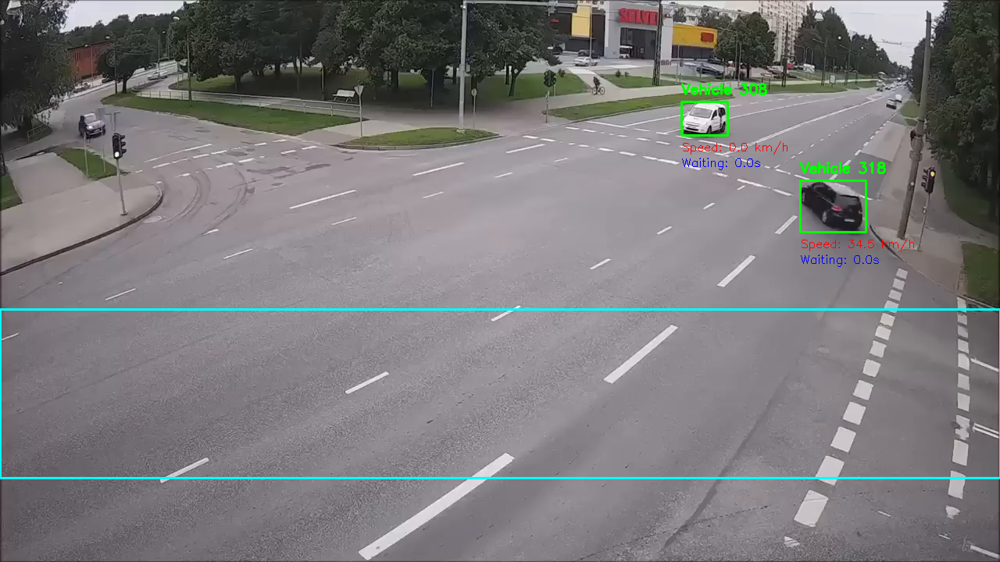


0: 384x640 (no detections), 24.7ms
Speed: 4.0ms preprocess, 24.7ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 19.7ms
Speed: 2.2ms preprocess, 19.7ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


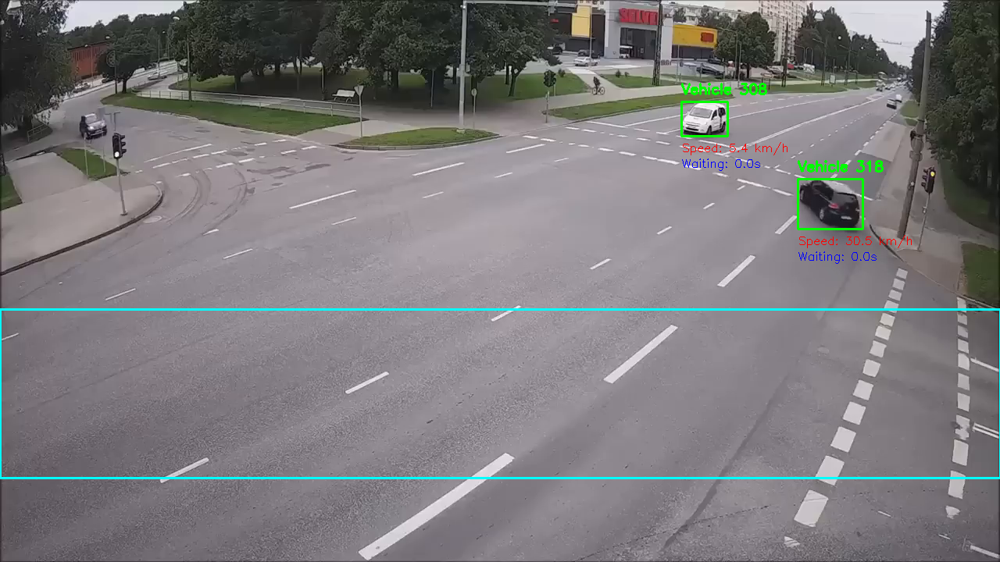


0: 384x640 (no detections), 18.6ms
Speed: 2.4ms preprocess, 18.6ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 17.1ms
Speed: 2.3ms preprocess, 17.1ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


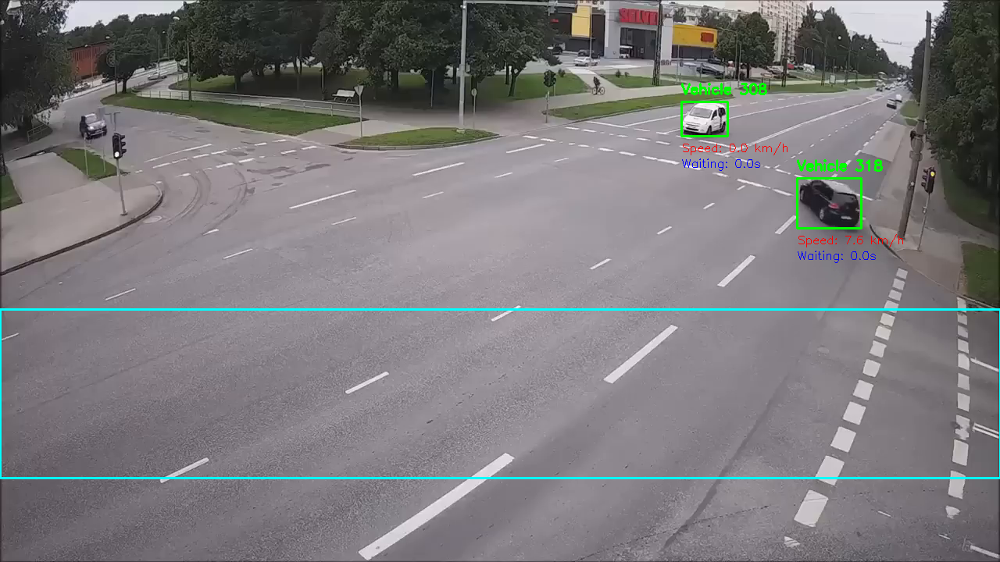


0: 384x640 (no detections), 16.5ms
Speed: 2.5ms preprocess, 16.5ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 14.6ms
Speed: 1.7ms preprocess, 14.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


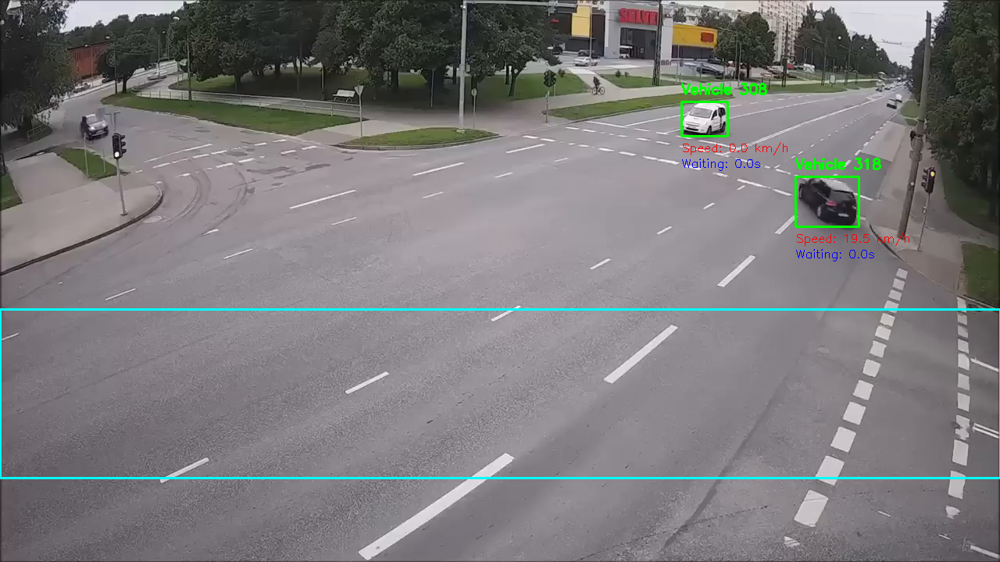


0: 384x640 (no detections), 21.5ms
Speed: 3.6ms preprocess, 21.5ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 20.2ms
Speed: 2.8ms preprocess, 20.2ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


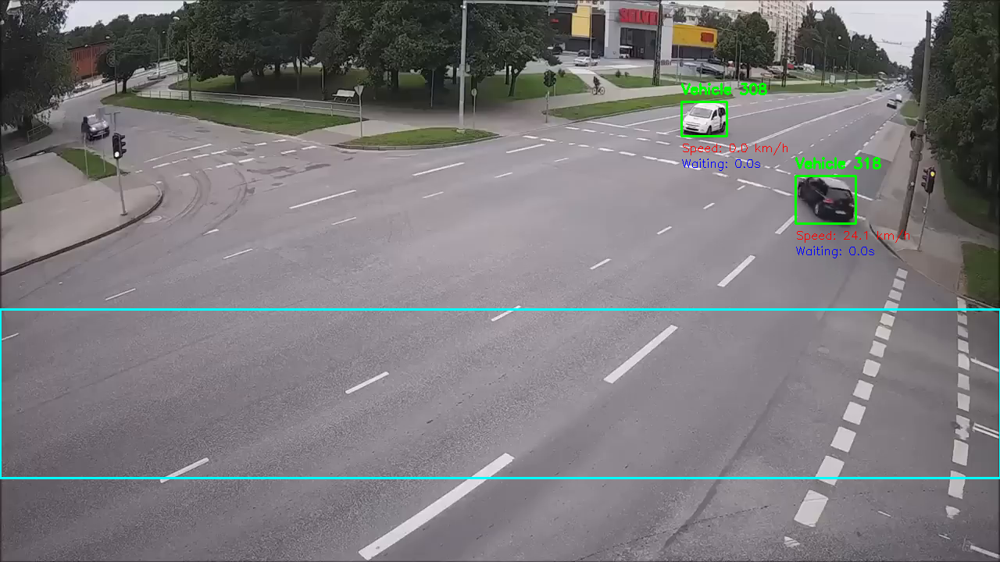


0: 384x640 (no detections), 20.9ms
Speed: 2.1ms preprocess, 20.9ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 20.7ms
Speed: 1.9ms preprocess, 20.7ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


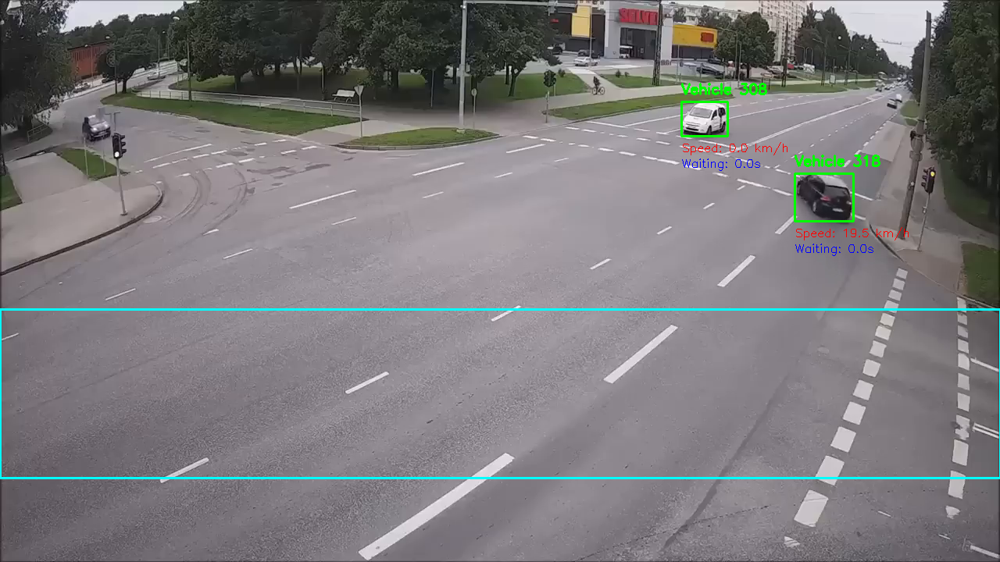


0: 384x640 (no detections), 20.2ms
Speed: 2.4ms preprocess, 20.2ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 20.8ms
Speed: 3.9ms preprocess, 20.8ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


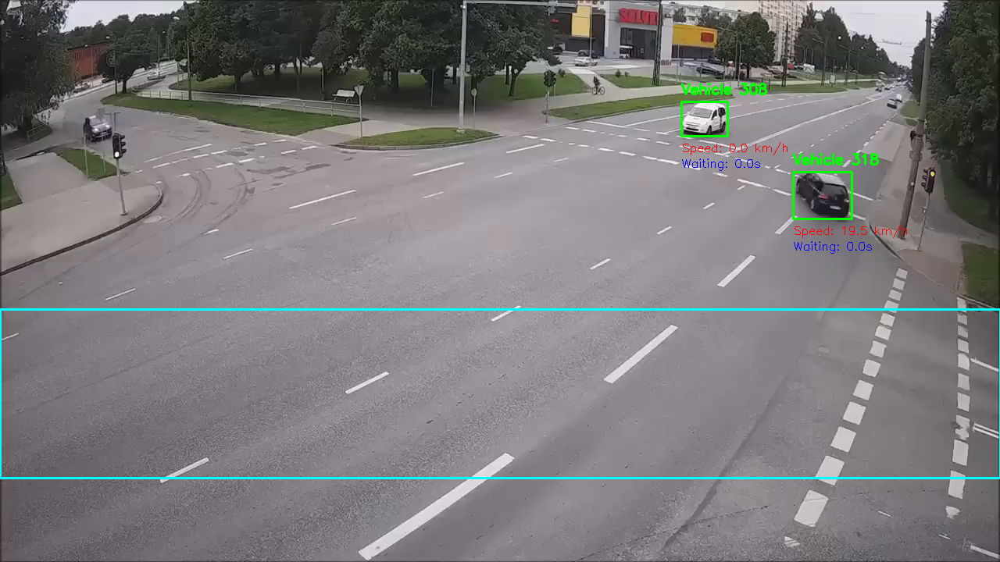


0: 384x640 (no detections), 14.5ms
Speed: 3.9ms preprocess, 14.5ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 12.5ms
Speed: 1.8ms preprocess, 12.5ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


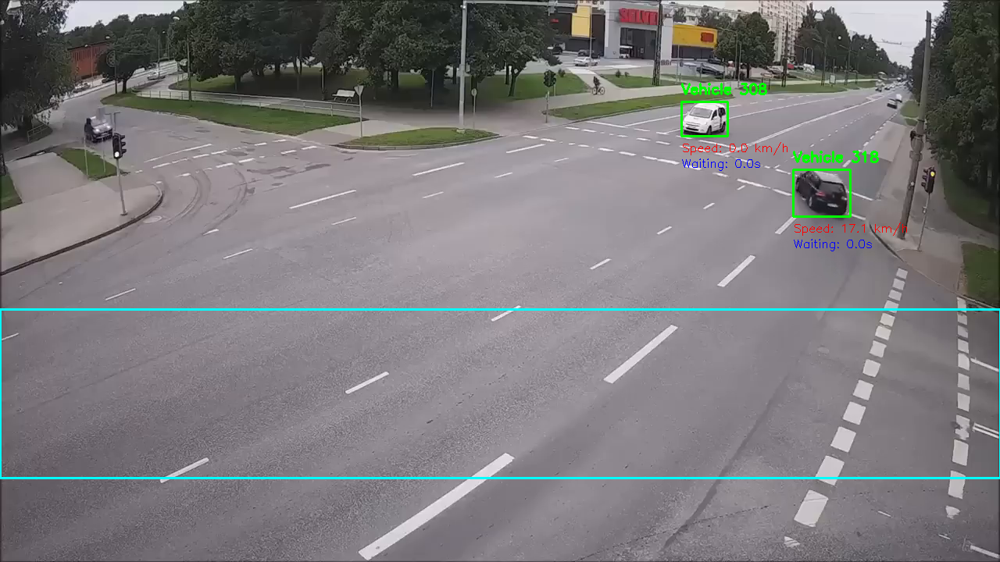


0: 384x640 (no detections), 19.2ms
Speed: 2.0ms preprocess, 19.2ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 17.4ms
Speed: 2.0ms preprocess, 17.4ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


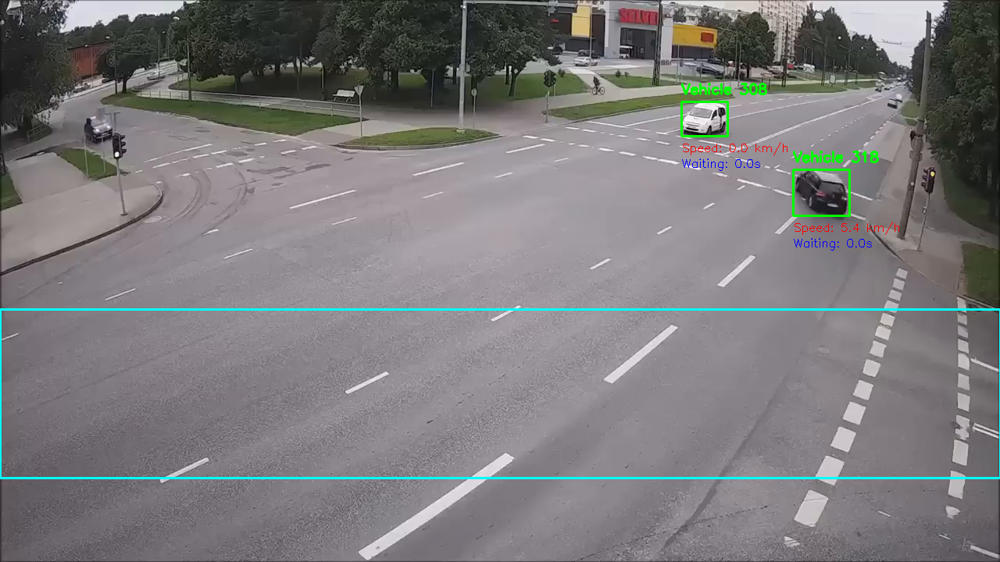


0: 384x640 (no detections), 13.6ms
Speed: 2.1ms preprocess, 13.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 12.7ms
Speed: 1.8ms preprocess, 12.7ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


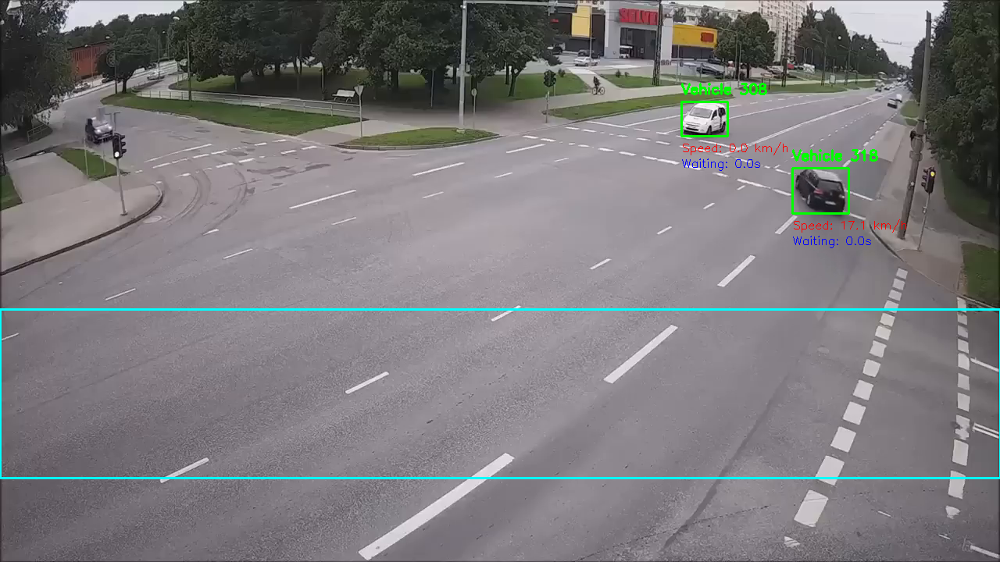


0: 384x640 (no detections), 23.6ms
Speed: 3.1ms preprocess, 23.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 22.0ms
Speed: 2.9ms preprocess, 22.0ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


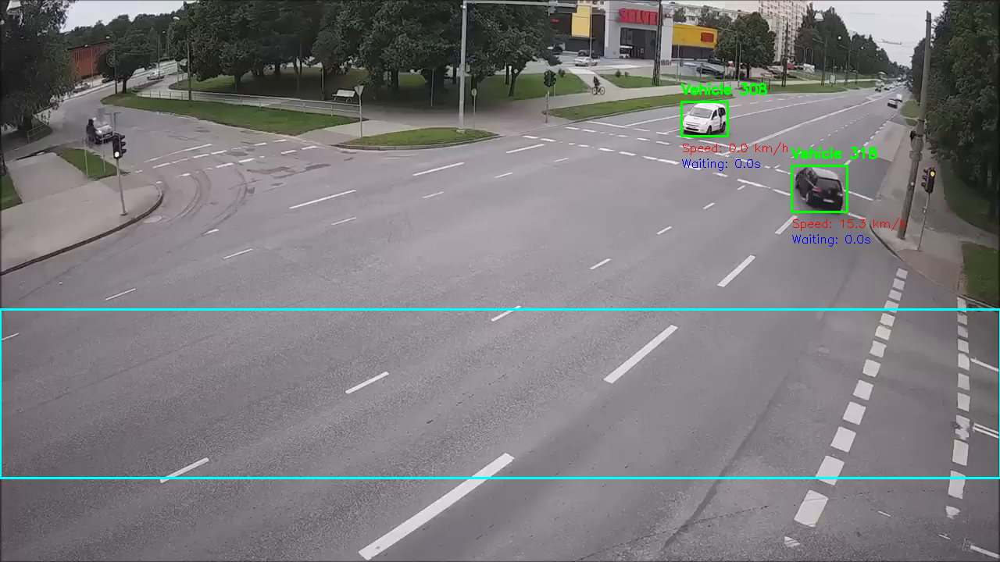


0: 384x640 (no detections), 18.9ms
Speed: 2.8ms preprocess, 18.9ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 16.3ms
Speed: 4.1ms preprocess, 16.3ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


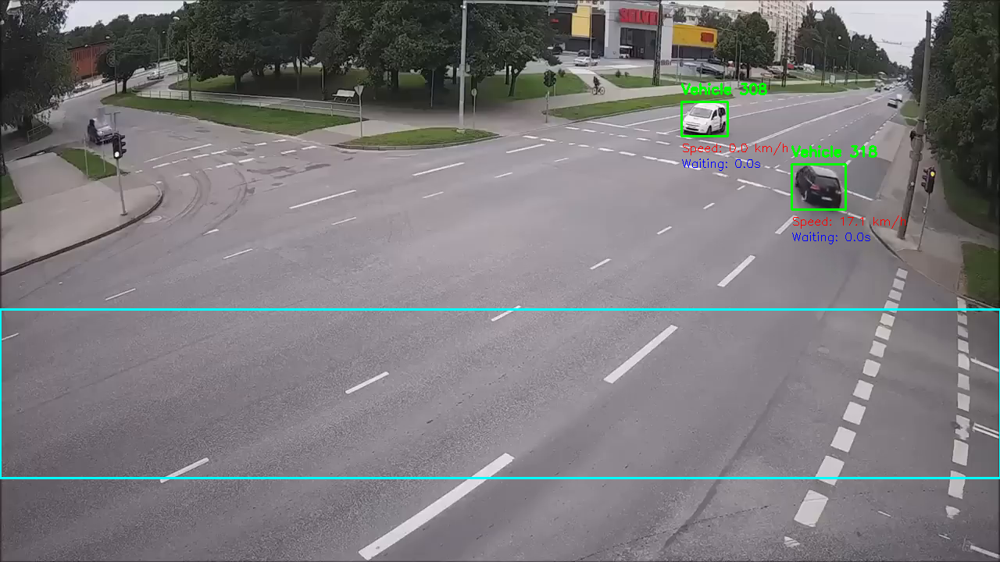


0: 384x640 (no detections), 15.6ms
Speed: 2.0ms preprocess, 15.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 17.0ms
Speed: 2.2ms preprocess, 17.0ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)


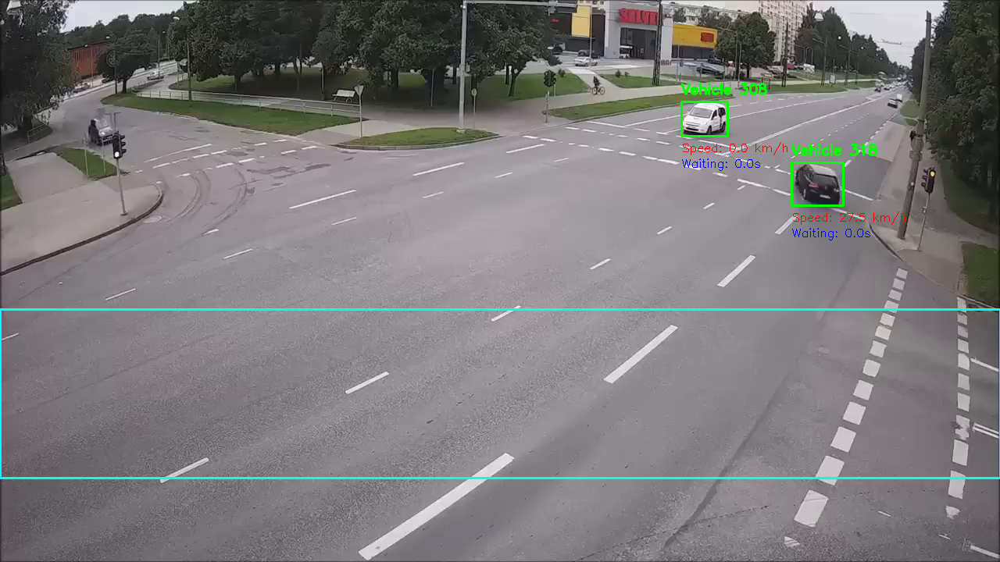


0: 384x640 (no detections), 13.9ms
Speed: 2.5ms preprocess, 13.9ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 16.7ms
Speed: 1.9ms preprocess, 16.7ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)


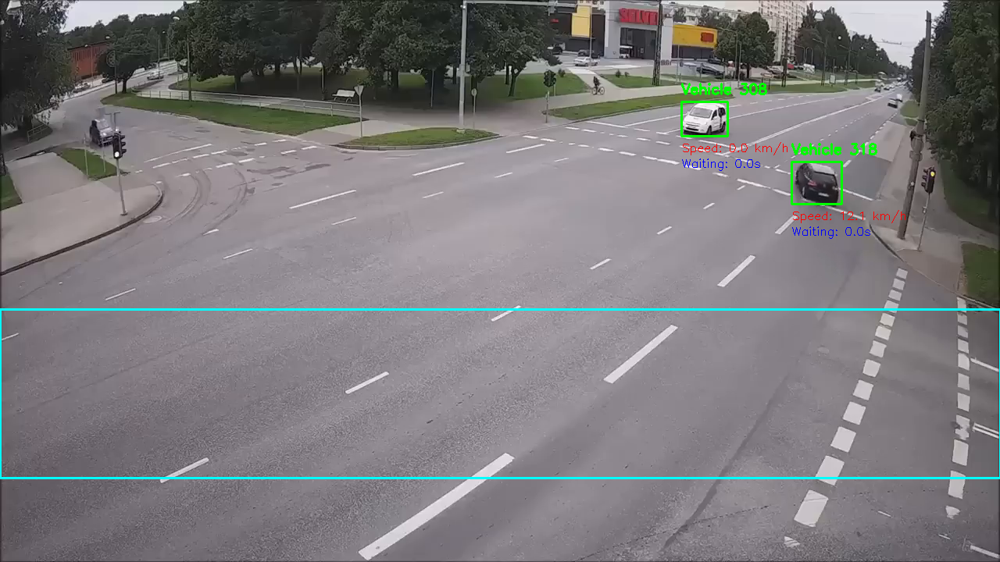


0: 384x640 (no detections), 14.6ms
Speed: 2.2ms preprocess, 14.6ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 cars, 15.3ms
Speed: 1.7ms preprocess, 15.3ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


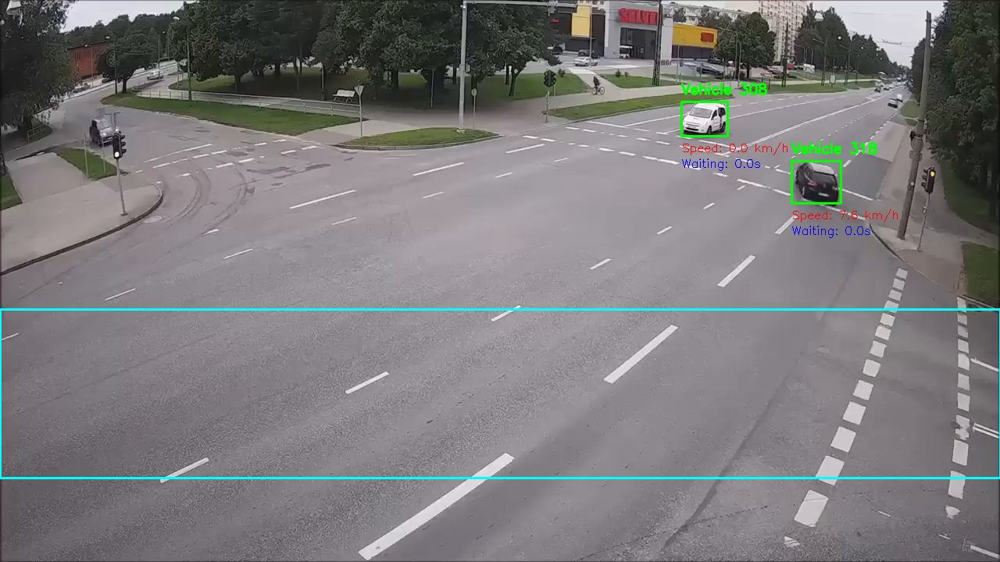


0: 384x640 (no detections), 17.8ms
Speed: 4.2ms preprocess, 17.8ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 15.2ms
Speed: 2.2ms preprocess, 15.2ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)


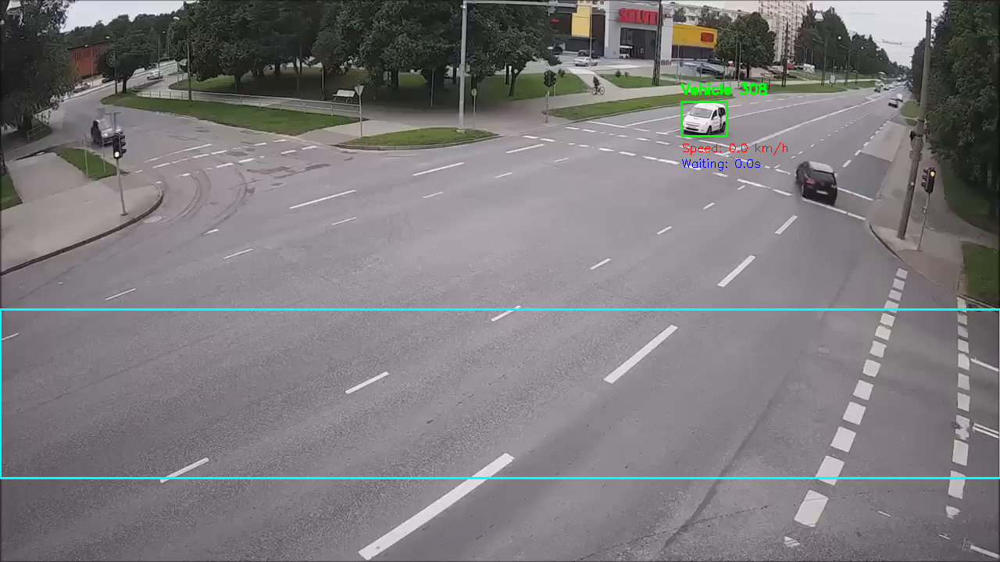


0: 384x640 (no detections), 14.9ms
Speed: 2.0ms preprocess, 14.9ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 12.6ms
Speed: 1.9ms preprocess, 12.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


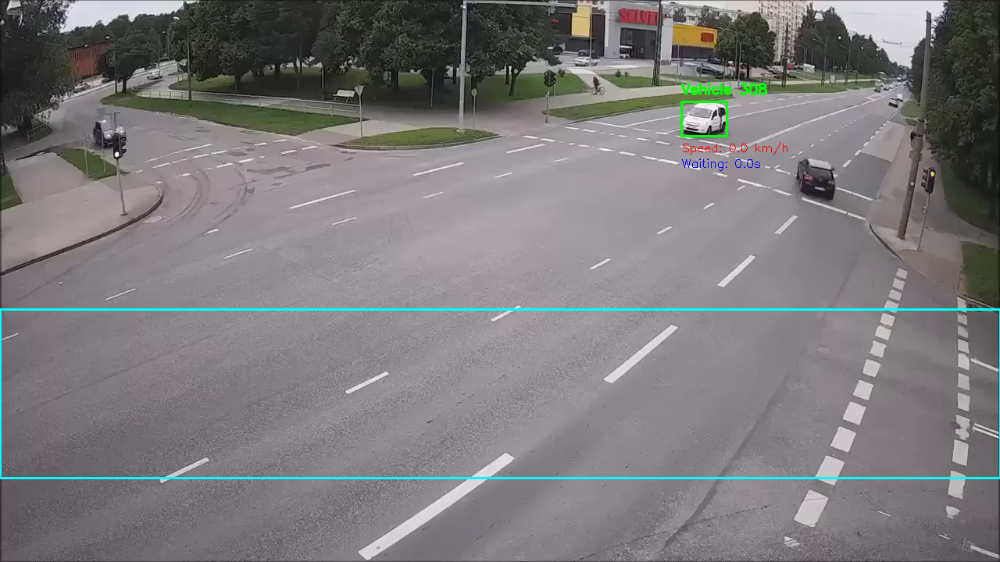


0: 384x640 (no detections), 15.9ms
Speed: 4.0ms preprocess, 15.9ms inference, 0.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 car, 14.8ms
Speed: 2.0ms preprocess, 14.8ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)


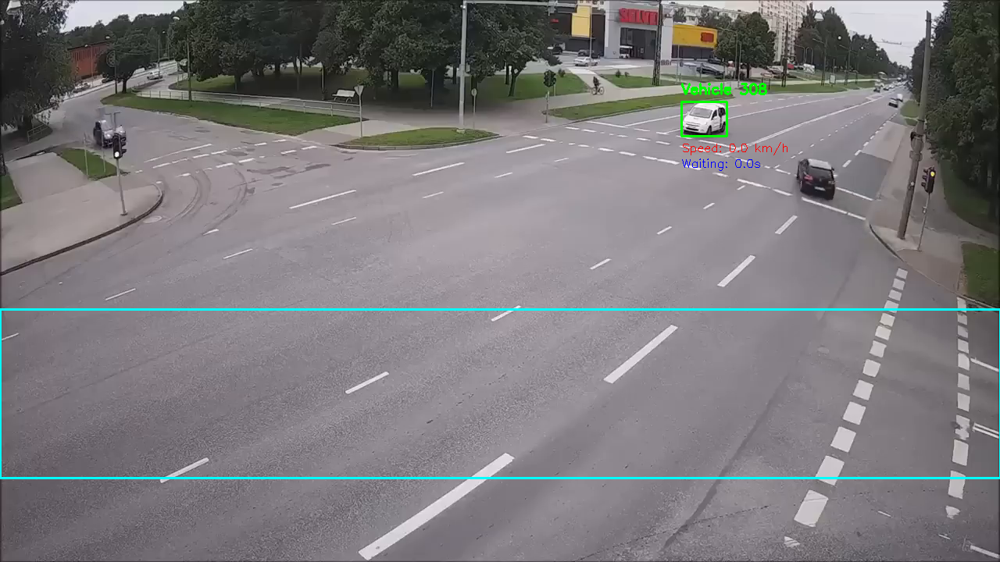


0: 384x640 (no detections), 15.2ms


In [ ]:
#  MAIN LOOP
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    #  CUSTOM MODEL
    custom_results = custom_model.track(
        frame,
        tracker="bytetrack.yaml",
        persist=True,
        imgsz=IMG_SIZE,
        conf=CONF_THRES
    )

    #  VEHICLE CHECK
    vehicle_found = False
    if custom_results and custom_results[0].boxes:
        for r in custom_results:
            for b in r.boxes:
                if int(b.cls[0]) in VEHICLE_CLASSES:
                    vehicle_found = True
                    break

    #  FALLBACK
    results = custom_results if vehicle_found else fallback_model.track(
        frame,
        tracker="bytetrack.yaml",
        persist=True,
        imgsz=IMG_SIZE,
        conf=CONF_THRES
    )

    #  PROCESS
    for r in results:
        for box in r.boxes:
            if box.id is None:
                continue

            cls_id = int(box.cls[0])
            if cls_id not in VEHICLE_CLASSES:
                continue

            x1, y1, x2, y2 = map(int, box.xyxy[0])
            cx = (x1 + x2) // 2
            cy = y2  # ground contact point

            #  VEHICLE ASSOCIATION
            tid = find_near_vehicle(cx, cy)
            if tid is None:
                tid = int(box.id[0])
                vehicle_tracks[tid] = {
                    "pos": (cx, cy),
                    "wait_frames": 0,
                    "speed": 0.0
                }

            track = vehicle_tracks[tid]

            #  SPEED (FRAME-BASED)
            dist_px = np.hypot(cx - track["pos"][0], cy - track["pos"][1])
            speed_kmh = (dist_px * PIXEL_TO_METER * fps) * 3.6

            #  WAITING TIME (FRAME-BASED & ACCURATE)
            inside_lane = ROI_Y_MIN < cy < ROI_Y_MAX

            if inside_lane and speed_kmh < STOP_SPEED_KMH:
                track["wait_frames"] += 1
            else:
                track["wait_frames"] = 0

            wait_time_s = track["wait_frames"] / fps

            #  UPDATE
            track["pos"] = (cx, cy)
            track["speed"] = speed_kmh

            #  DRAW
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0,255,0), 2)
            cv2.putText(frame, f"Vehicle {tid}", (x1, y1-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)

            cv2.putText(frame,
                        f"Speed: {speed_kmh:.1f} km/h",
                        (x1, y2+20),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)

            cv2.putText(frame,
                        f"Waiting: {wait_time_s:.1f}s",
                        (x1, y2+40),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,0,0), 1)

    #  DRAW ROI
    cv2.rectangle(frame, (0, ROI_Y_MIN), (width, ROI_Y_MAX),
                  (255,255,0), 2)

    out.write(frame)
    cv2_imshow(frame)

cap.release()
out.release()

print("FINAL FIX: FRAME-BASED WAITING TIME WORKING CORRECTLY")
print("Output:", OUTPUT_PATH)